In [ ]:
!pip install lime shap scikit-learn imblearn matplotlib seaborn pandas numpy

## **Improving Cardiovascular Disease Prediction Models with Explainable AI**

### Project Objective

To develop an **advanced deep learning model** for predicting **cardiovascular disease (CVD)** and integrate **Explainable AI (XAI)** techniques to identify which features most significantly influence the model’s predictions.

The goal is to:

- Build a robust deep learning model for accurate CVD prediction.
- Apply SHAP (SHapley Additive exPlanations) or similar techniques to explain the model’s behavior.
- Compare the insights derived from **Explainable AI** with the findings of **Exploratory Data Analysis (EDA)**.
- Validate the consistency of risk factors across both EDA and model explanations.


### Exploratory Data Analysis (EDA)


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import *

DATASET_ADDRESS = "/content/heart_failure_clinical_records_dataset.csv" # "content/heart_failure_clinical_records_dataset.csv"

In [3]:
df = pd.read_csv(DATASET_ADDRESS)
df.head()

,age,anaemia,creatinine_phosphokinase,diabetes,ejection_fraction,high_blood_pressure,platelets,serum_creatinine,serum_sodium,sex,smoking,time,DEATH_EVENT
0,75.0,0,582,0,20,1,265000.00,1.9,130,1,0,4,1
1,55.0,0,7861,0,38,0,263358.03,1.1,136,1,0,6,1
2,65.0,0,146,0,20,0,162000.00,1.3,129,1,1,7,1
3,50.0,1,111,0,20,0,210000.00,1.9,137,1,0,7,1
4,65.0,1,160,1,20,0,327000.00,2.7,116,0,0,8,1


In [4]:
def check_logical_validity(df):
    validation_rules = {
        "age": lambda x: x >= 0 and x <= 120,
        "anaemia": lambda x: x in [0, 1],
        "creatinine_phosphokinase": lambda x: x > 0,
        "diabetes": lambda x: x in [0, 1],
        "ejection_fraction": lambda x: x > 0 and x <= 100,
        "high_blood_pressure": lambda x: x in [0, 1],
        "platelets": lambda x: x > 0 and x < 1_000_000,
        "serum_creatinine": lambda x: x > 0,
        "serum_sodium": lambda x: x >= 100 and x <= 200,
        "sex": lambda x: x in [0, 1],
        "smoking": lambda x: x in [0, 1],
        "time": lambda x: x >= 0,
        "DEATH_EVENT": lambda x: x in [0, 1]
    }

    invalid_rows = []

    for col, rule in validation_rules.items():
        if col in df.columns:
            invalid = ~df[col].apply(rule)
            if invalid.any():
                print(f"Invalid entries found in column '{col}':")
                print(df.loc[invalid, [col]])
                print()
                invalid_rows.append(col)

    if not invalid_rows:
        print("All values are logically valid based on defined constraints.")
    else:
        print(f"Issues found in columns: {', '.join(invalid_rows)}")


In [5]:
check_logical_validity(df)

All values are logically valid based on defined constraints.


 Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 299 entries, 0 to 298
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   age                       299 non-null    float64
 1   anaemia                   299 non-null    int64  
 2   creatinine_phosphokinase  299 non-null    int64  
 3   diabetes                  299 non-null    int64  
 4   ejection_fraction         299 non-null    int64  
 5   high_blood_pressure       299 non-null    int64  
 6   platelets                 299 non-null    float64
 7   serum_creatinine          299 non-null    float64
 8   serum_sodium              299 non-null    int64  
 9   sex                       299 non-null    int64  
 10  smoking                   299 non-null    int64  
 11  time                      299 non-null    int64  
 12  DEATH_EVENT               299 non-null    int64  
dtypes: float64(3), int64(10)
memory usage: 30.5 KB
Non

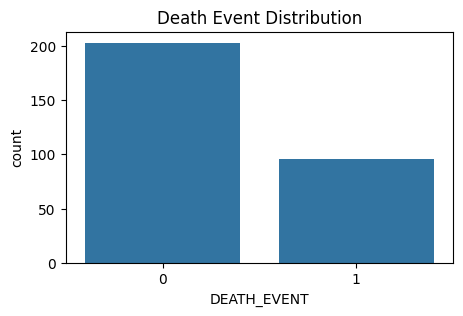

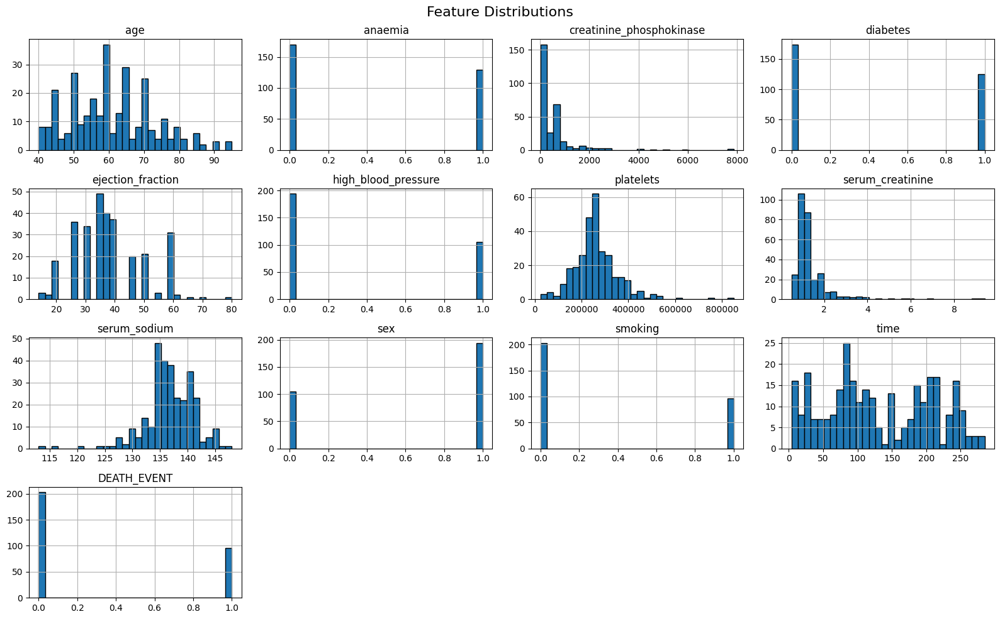

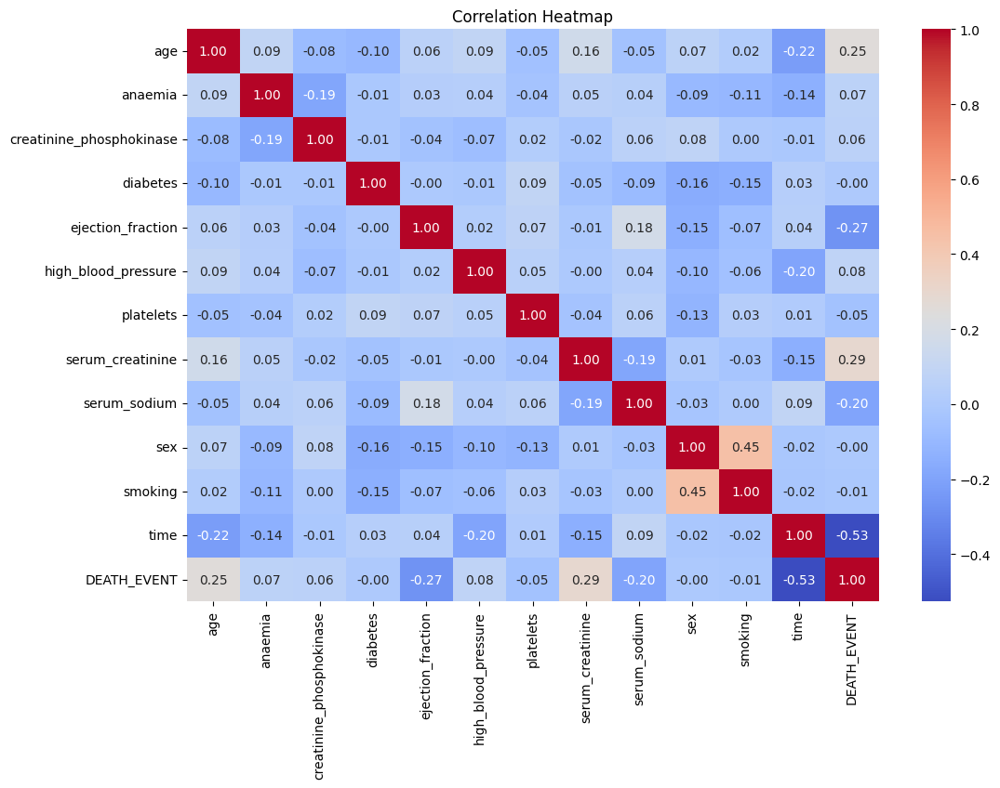

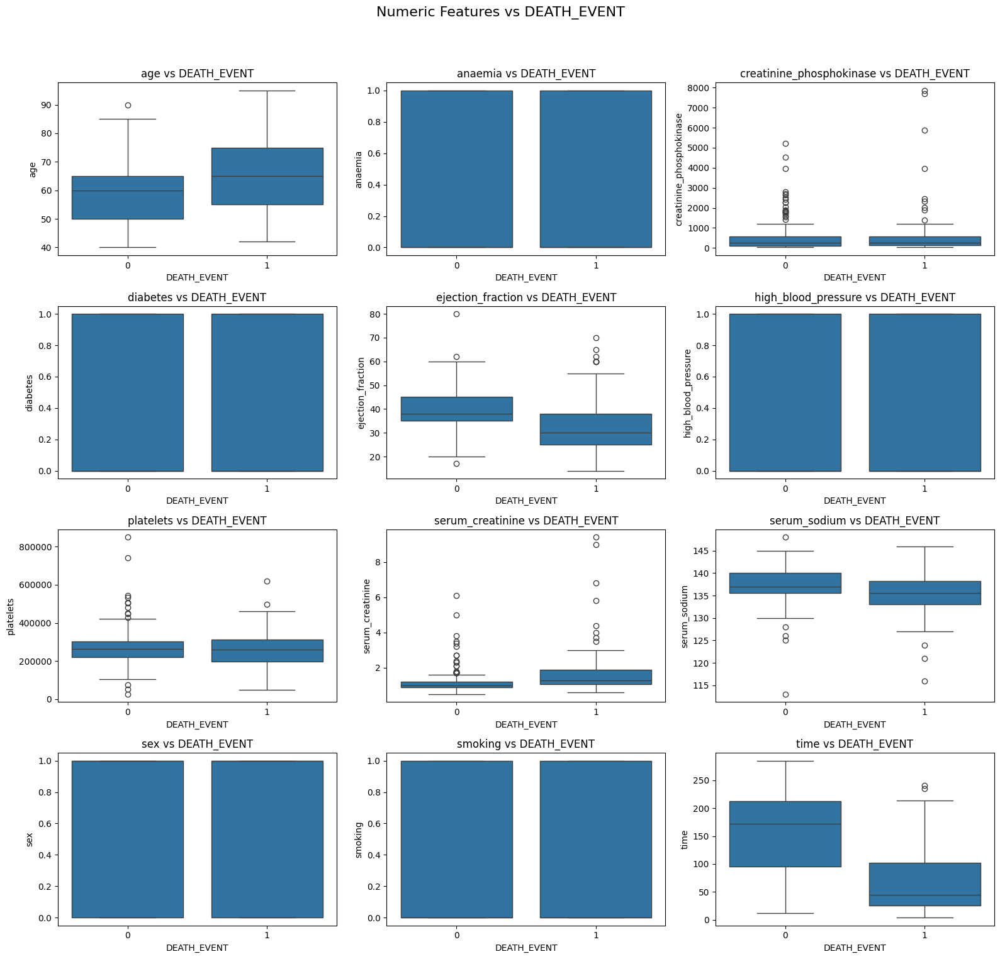

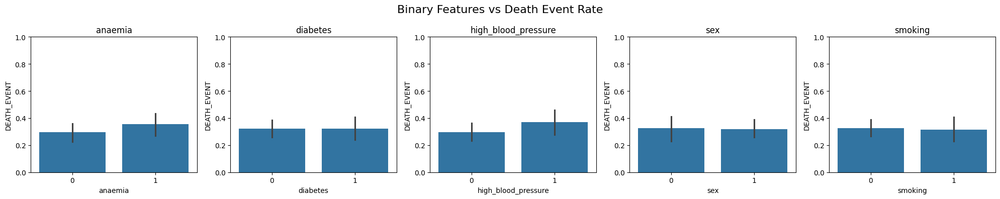

In [6]:
# Do different analyis on the dataset and plot some graphs to visualize relations.
# Basic overview
print(" Dataset Info:")
print(df.info())
print("\n Descriptive Statistics:")
print(df.describe())
print("\n Missing Values:")
print(df.isnull().sum())

# Plot 1: Target distribution
plt.figure(figsize=(5, 3))
sns.countplot(x="DEATH_EVENT", data=df)
plt.title("Death Event Distribution")
plt.show()

# Plot 2: Histograms - all numeric features
df.hist(bins=30, figsize=(16, 10), edgecolor='black')
plt.suptitle("Feature Distributions", fontsize=16)
plt.tight_layout()
plt.show()

# Plot 3: Correlation Heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(df.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

# Plot 4: Boxplots - numeric features vs DEATH_EVENT
numeric_features = df.select_dtypes(include='number').columns.drop("DEATH_EVENT")
n = len(numeric_features)
cols = 3
rows = (n + cols - 1) // cols

fig, axes = plt.subplots(rows, cols, figsize=(16, rows * 4))
fig.suptitle("Numeric Features vs DEATH_EVENT", fontsize=16)
for i, col in enumerate(numeric_features):
    ax = axes[i // cols, i % cols]
    sns.boxplot(x="DEATH_EVENT", y=col, data=df, ax=ax)
    ax.set_title(f"{col} vs DEATH_EVENT")
for j in range(i + 1, rows * cols):
    fig.delaxes(axes[j // cols, j % cols])
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

# Plot 5: Bar plots for binary features vs DEATH_EVENT
binary_features = ["anaemia", "diabetes", "high_blood_pressure", "sex", "smoking"]
fig, axes = plt.subplots(1, len(binary_features), figsize=(20, 4))
fig.suptitle("Binary Features vs Death Event Rate", fontsize=16)
for i, col in enumerate(binary_features):
    sns.barplot(x=col, y="DEATH_EVENT", data=df, ax=axes[i])
    axes[i].set_title(f"{col}")
    axes[i].set_ylim(0, 1)
plt.tight_layout()
plt.show()


## Exploratory Data Analysis (EDA) Report - Heart Failure Clinical Dataset

### Objective
The goal of this EDA is to understand the structure, distribution, and relationships in the dataset to guide effective feature engineering and model training for predicting patient survival (DEATH_EVENT).

---

### Dataset Overview

- **Total Samples:** 299  
- **Total Features:** 13  
- **Target Variable:** `DEATH_EVENT`  
- **No Missing Values**

| Feature Name                | Data Type | Description |
|----------------------------|-----------|-------------|
| age                        | Float     | Age of the patient |
| anaemia                    | Integer   | Presence of anaemia (1 = Yes) |
| creatinine_phosphokinase  | Integer   | Enzyme level in blood |
| diabetes                   | Integer   | Diabetes status (1 = Yes) |
| ejection_fraction          | Integer   | Percentage of blood leaving heart at each contraction |
| high_blood_pressure        | Integer   | Hypertension presence (1 = Yes) |
| platelets                  | Float     | Platelet count in the blood |
| serum_creatinine           | Float     | Level of creatinine in the blood |
| serum_sodium               | Integer   | Sodium level in the blood |
| sex                        | Integer   | Gender (1 = Male) |
| smoking                    | Integer   | Smoking status (1 = Yes) |
| time                       | Integer   | Follow-up period (days) |
| DEATH_EVENT                | Integer   | Death during follow-up (1 = Yes) |

---

### Descriptive Statistics Summary

| Feature                  | Mean     | Std Dev  | Min   | Max   |
|--------------------------|----------|----------|--------|--------|
| age                      | 60.83    | 11.89    | 40.0   | 95.0   |
| creatinine_phosphokinase| 581.84   | 970.29   | 23     | 7861   |
| ejection_fraction        | 38.08    | 11.83    | 14     | 80     |
| platelets                | 263358   | 97804    | 25100  | 850000 |
| serum_creatinine         | 1.39     | 1.03     | 0.5    | 9.4    |
| serum_sodium             | 136.63   | 4.41     | 113    | 148    |
| time                     | 130.26   | 77.61    | 4      | 285    |

---

### Target Variable: `DEATH_EVENT`

- **Class Balance:**  
  - 0 (Survived): ~68.9%  
  - 1 (Died): ~31.1%  
- Classes are **somewhat imbalanced** — consider stratified sampling and use of metrics like **F1-score**, **ROC-AUC**.
- Also use balancing algorithms like SMOTE or SMOTEEN since it is over sampled.

---

### Numeric Features: Key Observations

| Feature | Notes |
|--------|-------|
| `age` | Normal-like distribution; older age likely increases risk. Consider binning. |
| `creatinine_phosphokinase` | Heavily skewed with extreme outliers. Suggest log-transform or capping. |
| `ejection_fraction` | Critical feature. Lower values = poorer heart function. Strong signal for death. |
| `platelets` | Skewed, outliers present. May need normalization. |
| `serum_creatinine` | Skewed, outliers present. Higher values imply kidney issues — potential risk factor. |
| `serum_sodium` | Smaller range, but low sodium may indicate risk. Check with boxplots. |
| `time` | Important survival signal. May correlate with DEATH_EVENT (survivors tend to have longer follow-up). |

---

### Binary Features: Key Observations

| Feature | Positivity Rate | Notes |
|--------|------------------|-------|
| `anaemia` | ~43% | May influence death risk, especially combined with age or sex. |
| `diabetes` | ~42% | Known to increase HF risk. Likely useful. |
| `high_blood_pressure` | ~35% | Test interaction with age and DEATH_EVENT. |
| `sex` | ~65% male | Explore if males have higher risk, this happened because of sex is not balanced |
| `smoking` | ~32% | Alone might not be predictive — test in interaction with age and hypertension. |


> Based on EDA
 analysis do data transformations, normalization and so on... to experiment train the data with transformations and without is good.

### Base Model Training (Logistic Regression, Random Forest and SVM)


Cross-Validation Results for Logistic Regression:
accuracy: Mean = 0.81, Std = 0.06
precision: Mean = 0.81, Std = 0.10
recall: Mean = 0.83, Std = 0.05
f1: Mean = 0.82, Std = 0.05
roc_auc: Mean = 0.90, Std = 0.06

Model: Logistic Regression
Validation Set Evaluation:
              precision    recall  f1-score   support

           0       0.82      0.77      0.79        30
           1       0.79      0.84      0.81        31

    accuracy                           0.80        61
   macro avg       0.80      0.80      0.80        61
weighted avg       0.80      0.80      0.80        61



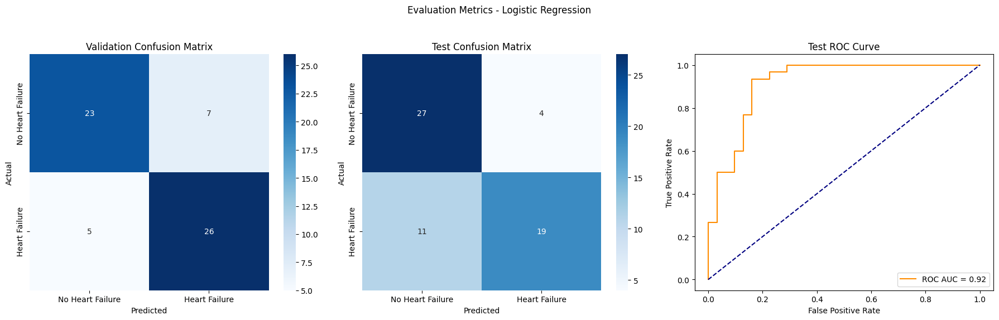


Cross-Validation Results for Random Forest:
accuracy: Mean = 0.88, Std = 0.05
precision: Mean = 0.85, Std = 0.06
recall: Mean = 0.92, Std = 0.06
f1: Mean = 0.88, Std = 0.05
roc_auc: Mean = 0.94, Std = 0.04

Model: Random Forest
Validation Set Evaluation:
              precision    recall  f1-score   support

           0       1.00      0.77      0.87        30
           1       0.82      1.00      0.90        31

    accuracy                           0.89        61
   macro avg       0.91      0.88      0.88        61
weighted avg       0.91      0.89      0.88        61



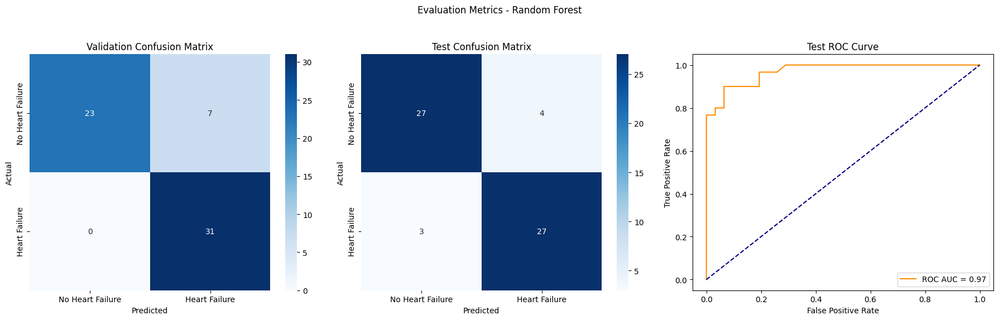


Cross-Validation Results for Support Vector Machine:
accuracy: Mean = 0.80, Std = 0.06
precision: Mean = 0.78, Std = 0.08
recall: Mean = 0.83, Std = 0.03
f1: Mean = 0.80, Std = 0.05
roc_auc: Mean = 0.88, Std = 0.08

Model: Support Vector Machine
Validation Set Evaluation:
              precision    recall  f1-score   support

           0       0.83      0.63      0.72        30
           1       0.71      0.87      0.78        31

    accuracy                           0.75        61
   macro avg       0.77      0.75      0.75        61
weighted avg       0.77      0.75      0.75        61



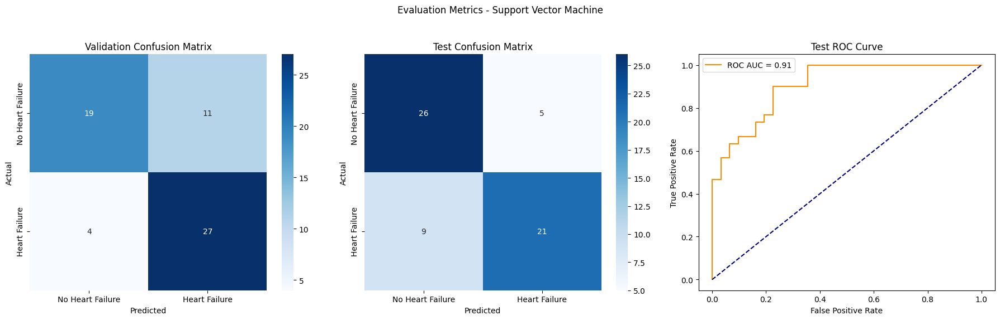


--- Hyperparameter Tuning ---

Best Logistic Regression Parameters: {'C': 10, 'solver': 'saga'}

Model: Tuned Logistic Regression
Validation Set Evaluation:
              precision    recall  f1-score   support

           0       0.83      0.80      0.81        30
           1       0.81      0.84      0.83        31

    accuracy                           0.82        61
   macro avg       0.82      0.82      0.82        61
weighted avg       0.82      0.82      0.82        61



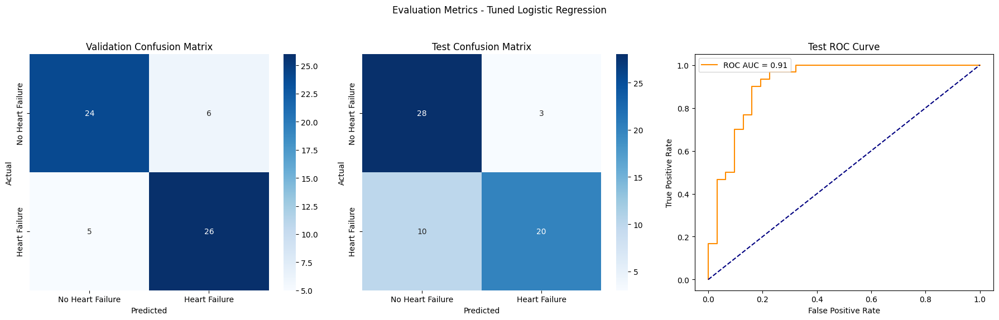


Best Random Forest Parameters: {'max_depth': 10, 'min_samples_split': 2, 'n_estimators': 200}

Model: Tuned Random Forest
Validation Set Evaluation:
              precision    recall  f1-score   support

           0       1.00      0.80      0.89        30
           1       0.84      1.00      0.91        31

    accuracy                           0.90        61
   macro avg       0.92      0.90      0.90        61
weighted avg       0.92      0.90      0.90        61



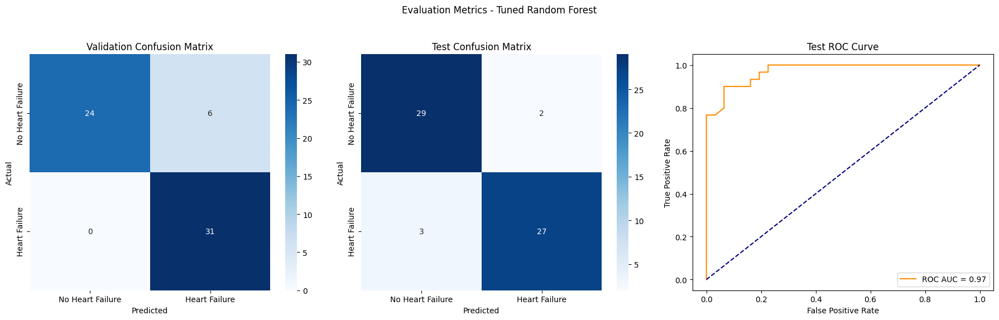


Best Support Vector Machine Parameters: {'C': 1, 'gamma': 'auto', 'kernel': 'rbf'}

Model: Tuned Support Vector Machine
Validation Set Evaluation:
              precision    recall  f1-score   support

           0       0.88      0.77      0.82        30
           1       0.80      0.90      0.85        31

    accuracy                           0.84        61
   macro avg       0.84      0.83      0.83        61
weighted avg       0.84      0.84      0.84        61



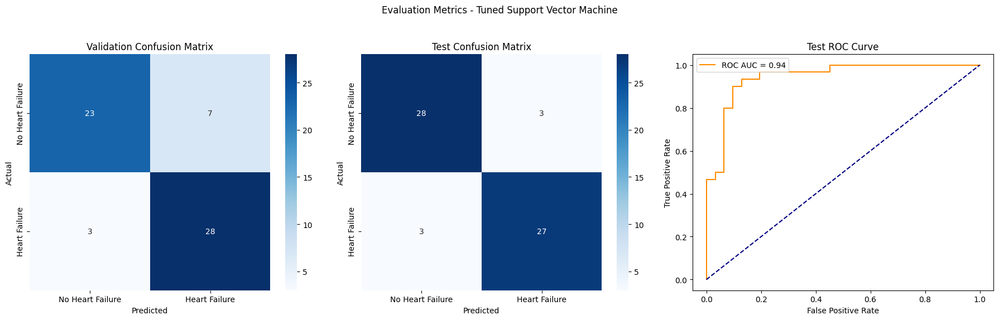

In [7]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import shap

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold, GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from imblearn.over_sampling import SMOTE


def load_and_preprocess_data(dataset_address):
    df = pd.read_csv(dataset_address)

    # Standardize continuous features
    continuous_vars = ['age', 'ejection_fraction', 'serum_sodium', 'time']
    scaler = StandardScaler()
    df[continuous_vars] = scaler.fit_transform(df[continuous_vars])

    # Log-transform skewed features
    for col in ['creatinine_phosphokinase', 'serum_creatinine', 'platelets']:
        df[col] = np.log1p(df[col])

    return df


def split_and_balance_data(df):
    X = df.drop(columns='DEATH_EVENT')
    y = df['DEATH_EVENT']

    oversample = SMOTE(random_state=42)
    X, y = oversample.fit_resample(X, y)

    X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.30, random_state=42, stratify=y)
    X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.50, random_state=42, stratify=y_temp)

    return X_train, X_val, X_test, y_train, y_val, y_test


def evaluate_model(name, model, X_train, y_train, X_val, y_val, X_test, y_test):
    model.fit(X_train, y_train)
    y_pred_val = model.predict(X_val)
    y_prob_val = model.predict_proba(X_val)[:, 1]
    y_pred_test = model.predict(X_test)
    y_prob_test = model.predict_proba(X_test)[:, 1]

    print(f'\nModel: {name}')
    print("Validation Set Evaluation:")
    print(classification_report(y_val, y_pred_val))

    roc_auc_test = roc_auc_score(y_test, y_prob_test)

    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    fig.suptitle(f'Evaluation Metrics - {name}')

    sns.heatmap(confusion_matrix(y_val, y_pred_val), annot=True, fmt='d', cmap='Blues',
                xticklabels=['No Heart Failure', 'Heart Failure'],
                yticklabels=['No Heart Failure', 'Heart Failure'], ax=axes[0])
    axes[0].set_title('Validation Confusion Matrix')
    axes[0].set_xlabel('Predicted')
    axes[0].set_ylabel('Actual')

    sns.heatmap(confusion_matrix(y_test, y_pred_test), annot=True, fmt='d', cmap='Blues',
                xticklabels=['No Heart Failure', 'Heart Failure'],
                yticklabels=['No Heart Failure', 'Heart Failure'], ax=axes[1])
    axes[1].set_title('Test Confusion Matrix')
    axes[1].set_xlabel('Predicted')
    axes[1].set_ylabel('Actual')

    fpr, tpr, _ = roc_curve(y_test, y_prob_test)
    axes[2].plot(fpr, tpr, label=f'ROC AUC = {roc_auc_test:.2f}', color='darkorange')
    axes[2].plot([0, 1], [0, 1], linestyle='--', color='navy')
    axes[2].set_title('Test ROC Curve')
    axes[2].set_xlabel('False Positive Rate')
    axes[2].set_ylabel('True Positive Rate')
    axes[2].legend()

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

    return {
        'model': model,
        'X_train': X_train,
        'X_val': X_val,
        'X_test': X_test,
        'y_train': y_train,
        'y_val': y_val,
        'y_test': y_test,
        'y_pred_val': y_pred_val,
        'y_prob_val': y_prob_val,
        'y_pred_test': y_pred_test,
        'y_prob_test': y_prob_test
    }


def cross_validate_model(name, model, X, y, cv=5):
    print(f"\nCross-Validation Results for {name}:")
    metrics = ['accuracy', 'precision', 'recall', 'f1', 'roc_auc']
    for metric in metrics:
        scores = cross_val_score(model, X, y, cv=cv, scoring=metric)
        print(f'{metric}: Mean = {scores.mean():.2f}, Std = {scores.std():.2f}')


def tune_and_evaluate(model_name, model, param_grid, X_train, y_train, X_val, y_val, X_test, y_test):
    grid_search = GridSearchCV(model, param_grid, cv=StratifiedKFold(n_splits=3, shuffle=True, random_state=42),
                               scoring='roc_auc', n_jobs=-1)
    grid_search.fit(X_train, y_train)
    best_model = grid_search.best_estimator_
    print(f"\nBest {model_name} Parameters: {grid_search.best_params_}")

    model_info = evaluate_model(f"Tuned {model_name}", best_model, X_train, y_train, X_val, y_val, X_test, y_test)

    # Add SHAP explainer if applicable
    if isinstance(best_model, LogisticRegression):
        explainer = shap.Explainer(best_model, X_train)
        shap_values = explainer(X_val)
        model_info.update({
            'explainer': explainer,
            'shap_values': shap_values
        })

    return model_info

trained_base_models = {}

df = load_and_preprocess_data(DATASET_ADDRESS)
X_train, X_val, X_test, y_train, y_val, y_test = split_and_balance_data(df)

models = {
    'Logistic Regression': LogisticRegression(max_iter=1000, random_state=42),
    'Random Forest': RandomForestClassifier(n_estimators=100, random_state=42),
    'Support Vector Machine': SVC(probability=True, random_state=42)
}

for name, model in models.items():
    cross_validate_model(name, model, X_train, y_train, cv=StratifiedKFold(n_splits=5, shuffle=True, random_state=42))
    model_info = evaluate_model(name, model, X_train, y_train, X_val, y_val, X_test, y_test)
    trained_base_models[name] = model_info

print("\n--- Hyperparameter Tuning ---")

trained_base_models['Tuned Logistic Regression'] = tune_and_evaluate(
    "Logistic Regression",
    LogisticRegression(max_iter=1000, random_state=42),
    {'C': [0.001, 0.01, 0.1, 1, 10, 100], 'solver': ['liblinear', 'saga']},
    X_train, y_train, X_val, y_val, X_test, y_test
)

trained_base_models['Tuned Random Forest'] = tune_and_evaluate(
    "Random Forest",
    RandomForestClassifier(random_state=42),
    {'n_estimators': [50, 100, 200], 'max_depth': [None, 5, 10], 'min_samples_split': [2, 5, 10]},
    X_train, y_train, X_val, y_val, X_test, y_test
)

trained_base_models['Tuned Support Vector Machine'] = tune_and_evaluate(
    "Support Vector Machine",
    SVC(probability=True, random_state=42),
    {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf'], 'gamma': ['scale', 'auto']},
    X_train, y_train, X_val, y_val, X_test, y_test
)

### Neural networks Training (CNN, LSTM and CNN-LSTM)


Training model: CNN


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Epoch 1/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 26ms/step - accuracy: 0.6253 - loss: 0.7481 - val_accuracy: 0.5082 - val_loss: 0.6874 - learning_rate: 0.0010
Epoch 2/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.6655 - loss: 0.7560 - val_accuracy: 0.7377 - val_loss: 0.6410 - learning_rate: 0.0010
Epoch 3/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.7557 - loss: 0.6811 - val_accuracy: 0.4918 - val_loss: 0.7231 - learning_rate: 0.0010
Epoch 4/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.7861 - loss: 0.4465 - val_accuracy: 0.4918 - val_loss: 0.8402 - learning_rate: 0.0010
Epoch 5/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.7429 - loss: 0.5671 - val_accuracy: 0.5410 - val_loss: 0.6768 - learning_rate: 0.0010
Epoch 6/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.7545 - loss: 0.5989 - val_accuracy: 0.5738 - val_loss: 0.6498 - learning_rate: 0.0010
Epoch 7/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.7635 - loss: 0.5508 - val_acc

/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - accuracy: 0.5092 - loss: 0.6925 - val_accuracy: 0.5082 - val_loss: 0.6863 - learning_rate: 0.0010
Epoch 2/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.4679 - loss: 0.6948 - val_accuracy: 0.5082 - val_loss: 0.6830 - learning_rate: 0.0010
Epoch 3/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5280 - loss: 0.6920 - val_accuracy: 0.7869 - val_loss: 0.6738 - learning_rate: 0.0010
Epoch 4/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5571 - loss: 0.6825 - val_accuracy: 0.7705 - val_loss: 0.6532 - learning_rate: 0.0010
Epoch 5/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.6032 - loss: 0.6626 - val_accuracy: 0.8033 - val_loss: 0.5941 - learning_rate: 0.0010
Epoch 6/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.6051 - loss: 0.6609 - val_accuracy: 0.7869 - val_loss: 0.5620 - learning_rate: 0.0010
Epoch 7/50
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.5916 - loss: 0.6379 - val_acc

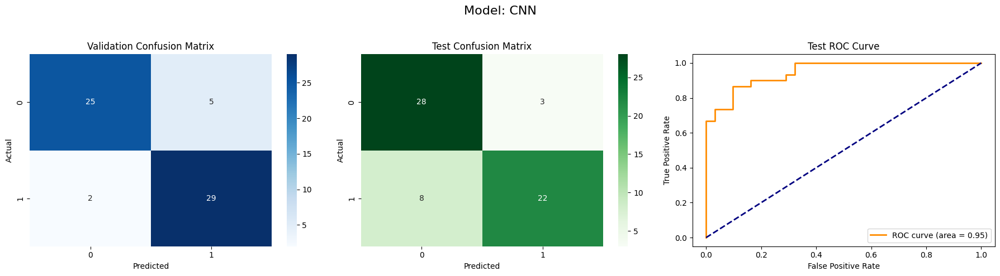

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


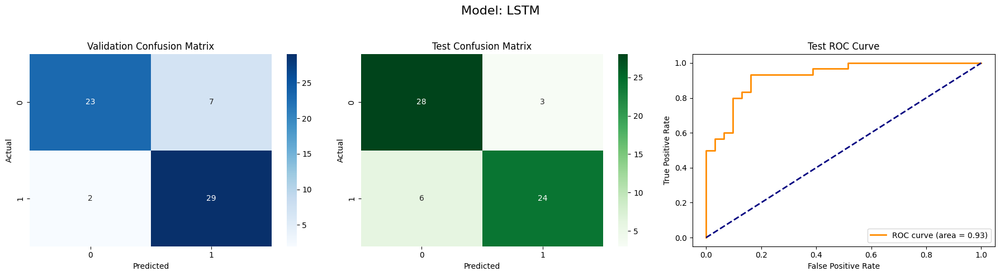

1/2 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


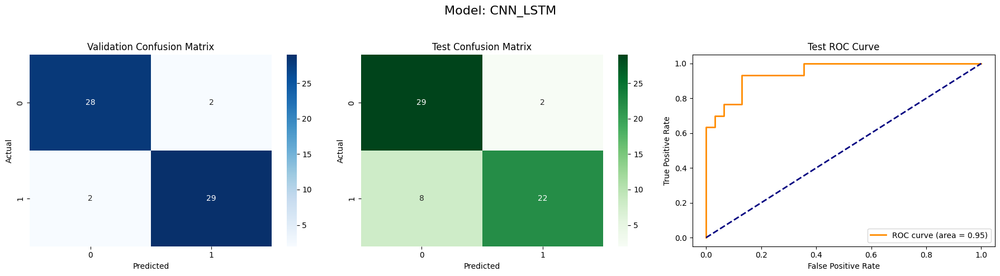

2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 2s/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


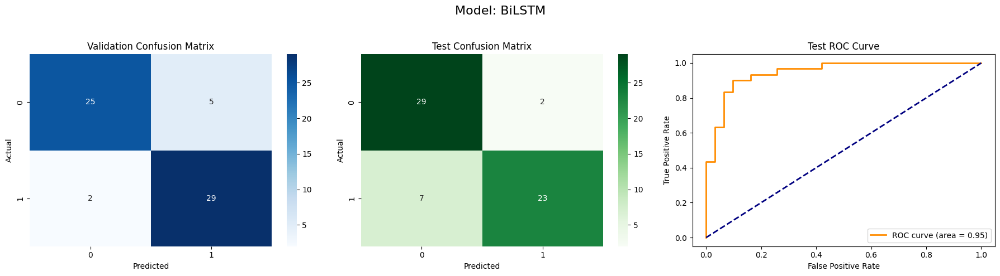

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 921ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


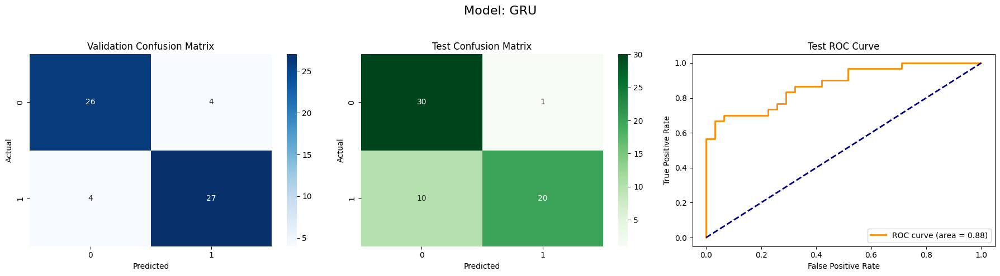

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 627ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


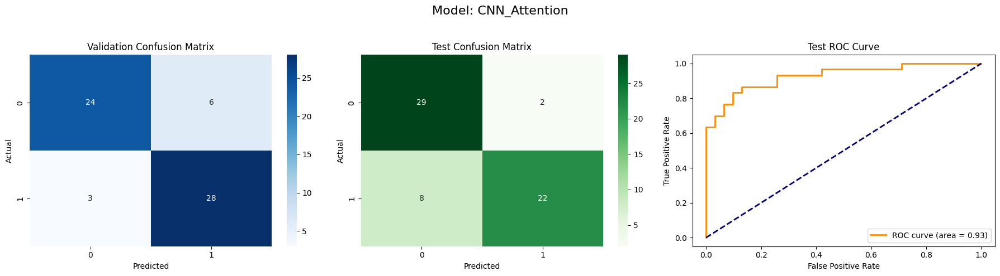

In [8]:
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from imblearn.over_sampling import SMOTE
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import *
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
import seaborn as sns
import matplotlib.pyplot as plt


def load_and_preprocess_data(dataset_address):
    df = pd.read_csv(dataset_address)

    # Standardize continuous variables
    continuous_vars = ['age', 'ejection_fraction', 'serum_sodium', 'time']
    scaler = StandardScaler()
    df[continuous_vars] = scaler.fit_transform(df[continuous_vars])

    # Log-transform skewed variables
    for col in ['creatinine_phosphokinase', 'serum_creatinine', 'platelets']:
        df[col] = np.log1p(df[col])

    return df


def split_and_balance_data(df):
    X = df.drop(columns='DEATH_EVENT')
    y = df['DEATH_EVENT']

    oversample = SMOTE(random_state=42)
    X, y = oversample.fit_resample(X, y)

    X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)
    X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, stratify=y_temp, random_state=42)

    # Reshape for sequence-based input (samples, timesteps, features)
    X_train_original = X_train.copy()
    X_val_original = X_val.copy()
    X_test_original = X_test.copy()

    X_train = np.expand_dims(X_train.values, axis=2)
    X_val = np.expand_dims(X_val.values, axis=2)
    X_test = np.expand_dims(X_test.values, axis=2)

    return X_train, X_val, X_test, y_train, y_val, y_test, X_train_original, X_val_original, X_test_original

def plot_metrics(y_val, val_probs, y_test, test_probs, model_name):
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))

    val_preds = (val_probs > 0.5).astype(int)
    test_preds = (test_probs > 0.5).astype(int)

    sns.heatmap(confusion_matrix(y_val, val_preds), annot=True, fmt='d', cmap='Blues', ax=axes[0])
    axes[0].set_title('Validation Confusion Matrix')
    axes[0].set_xlabel('Predicted')
    axes[0].set_ylabel('Actual')

    sns.heatmap(confusion_matrix(y_test, test_preds), annot=True, fmt='d', cmap='Greens', ax=axes[1])
    axes[1].set_title('Test Confusion Matrix')
    axes[1].set_xlabel('Predicted')
    axes[1].set_ylabel('Actual')

    fpr, tpr, _ = roc_curve(y_test, test_probs)
    roc_auc = auc(fpr, tpr)
    axes[2].plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
    axes[2].plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    axes[2].set_title('Test ROC Curve')
    axes[2].set_xlabel('False Positive Rate')
    axes[2].set_ylabel('True Positive Rate')
    axes[2].legend(loc="lower right")

    fig.suptitle(f'Model: {model_name}', fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

def evaluate_model(model, X_val, y_val, X_test, y_test, model_name):
    val_probs = model.predict(X_val)
    test_probs = model.predict(X_test)
    plot_metrics(y_val, val_probs, y_test, test_probs, model_name)

# CNN model
def build_cnn_model(input_shape):
    model = Sequential()

    model.add(Conv1D(32, kernel_size=3, padding='same', input_shape=input_shape))
    model.add(LeakyReLU(alpha=0.001))
    model.add(BatchNormalization())

    model.add(Conv1D(64, kernel_size=3, padding='same'))
    model.add(LeakyReLU(alpha=0.001))
    model.add(BatchNormalization())

    model.add(Conv1D(128, kernel_size=3, padding='same'))
    model.add(LeakyReLU(alpha=0.001))
    model.add(BatchNormalization())

    model.add(MaxPool1D(pool_size=3, strides=2, padding='same'))
    model.add(Dropout(0.5))

    model.add(Flatten())

    model.add(Dense(256))
    model.add(LeakyReLU(alpha=0.001))
    model.add(BatchNormalization())

    model.add(Dense(512))
    model.add(LeakyReLU(alpha=0.001))
    model.add(BatchNormalization())

    model.add(Dense(1, activation='sigmoid'))
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

    return model

# LSTM model
def build_lstm_model(input_shape):
    model = Sequential()
    model.add(LSTM(64, return_sequences=True, input_shape=input_shape))
    model.add(Dropout(0.3))

    model.add(LSTM(32))
    model.add(Dropout(0.3))

    model.add(Dense(64, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))

    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model


# CNN-LSTM hybrid model
def build_cnn_lstm_model(input_shape):
    model = Sequential()
    model.add(Conv1D(64, kernel_size=3, padding='same', activation='relu', input_shape=input_shape))
    model.add(MaxPool1D(pool_size=2))

    model.add(LSTM(64, return_sequences=False))
    model.add(Dropout(0.3))

    model.add(Dense(64, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))

    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model


def train_model(model, X_train, y_train, X_val, y_val):
    early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5)

    history = model.fit(
        X_train, y_train,
        validation_data=(X_val, y_val),
        epochs=50,
        batch_size=10,
        callbacks=[early_stop, reduce_lr],
        verbose=1
    )

    return model, history


def build_bilstm_model(input_shape):
    model = Sequential()
    model.add(tf.keras.Input(shape=input_shape))
    model.add(tf.keras.layers.Bidirectional(LSTM(64, return_sequences=True)))
    model.add(Dropout(0.3))
    model.add(tf.keras.layers.Bidirectional(LSTM(32)))
    model.add(Dropout(0.3))
    model.add(Dense(64, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))

    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model



def build_gru_model(input_shape):
    model = Sequential()
    model.add(tf.keras.Input(shape=input_shape))
    model.add(tf.keras.layers.GRU(64, return_sequences=True))
    model.add(Dropout(0.3))
    model.add(tf.keras.layers.GRU(32))
    model.add(Dropout(0.3))
    model.add(Dense(64, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))

    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model



def build_cnn_attention_model(input_shape):
    inputs = tf.keras.Input(shape=input_shape)

    x = Conv1D(64, kernel_size=3, padding='same', activation='relu')(inputs)
    x = MaxPool1D(pool_size=2)(x)

    # Attention mechanism
    attention = Dense(1, activation='tanh')(x)
    attention = tf.keras.layers.Flatten()(attention)
    attention = tf.keras.layers.Activation('softmax')(attention)
    attention = tf.keras.layers.RepeatVector(64)(attention)
    attention = tf.keras.layers.Permute([2, 1])(attention)

    x = tf.keras.layers.multiply([x, attention])
    x = tf.keras.layers.LSTM(64)(x)

    x = Dense(64, activation='relu')(x)
    outputs = Dense(1, activation='sigmoid')(x)

    model = tf.keras.Model(inputs=inputs, outputs=outputs)
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model


df = load_and_preprocess_data(DATASET_ADDRESS)
X_train, X_val, X_test, y_train, y_val, y_test, X_train_original, X_val_original, X_test_original = split_and_balance_data(df)

model_builders = {
    'CNN': build_cnn_model,
    'LSTM': build_lstm_model,
    'CNN_LSTM': build_cnn_lstm_model,
    'BiLSTM': build_bilstm_model,
    'GRU': build_gru_model,
    'CNN_Attention': build_cnn_attention_model
}

trained_neural_models = {}

for name, builder in model_builders.items():
    print(f"\nTraining model: {name}")
    model = builder(input_shape=(X_train.shape[1], 1))
    model, _ = train_model(model, X_train, y_train, X_val, y_val)
    trained_neural_models[name] = {
        'model': model,
        'X_train': X_train,
        'X_val': X_val,
        'X_test': X_test,
        'X_train_original': X_train_original,
        'X_val_original': X_val_original,
        'X_test_original': X_test_original,
        'y_train': y_train,
        'y_val': y_val,
        'y_test': y_test
    }

for name, model in trained_neural_models.items():
    evaluate_model(model['model'], X_val, y_val, X_test, y_test, name)


### Apply XAI on Trained Models

SHAP ANALYSIS FOR LOGISTIC REGRESSION


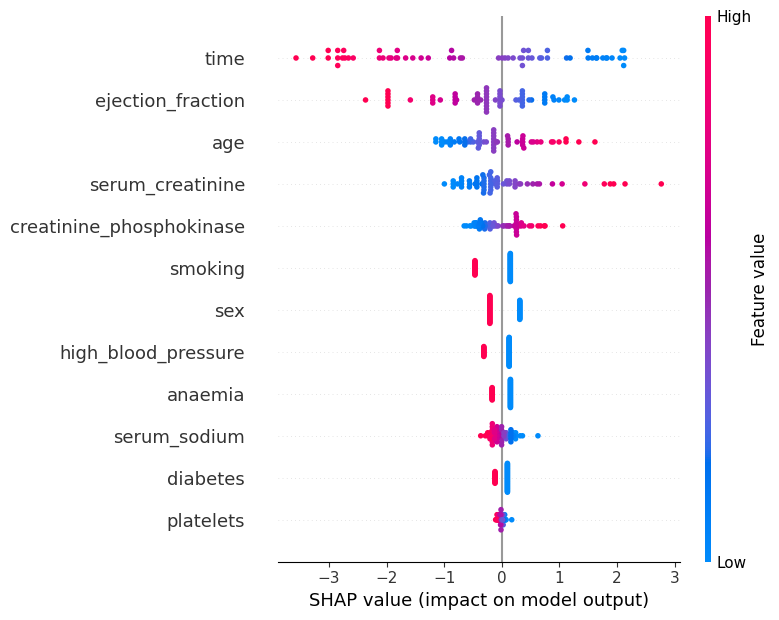

SHAP ANALYSIS FOR LOGISTIC REGRESSION


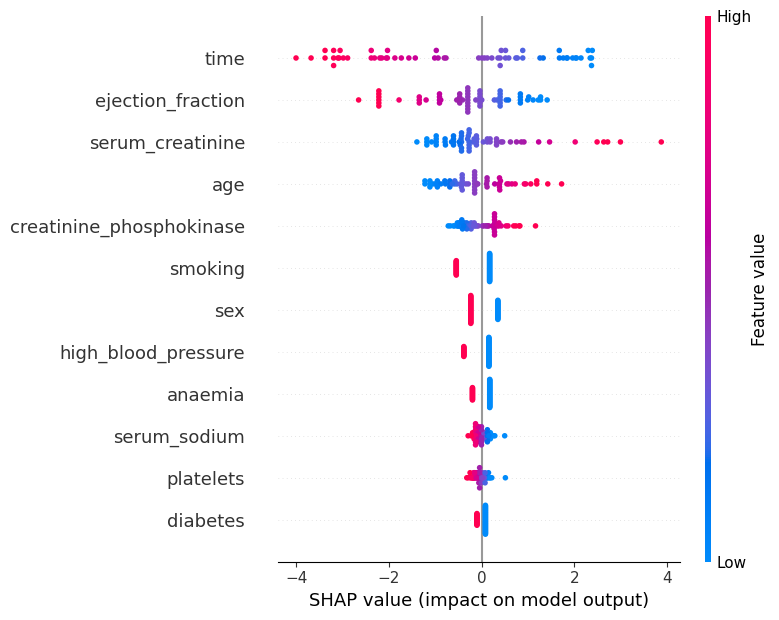

SHAP ANALYSIS FOR SVM


  0%|          | 0/61 [00:00<?, ?it/s]

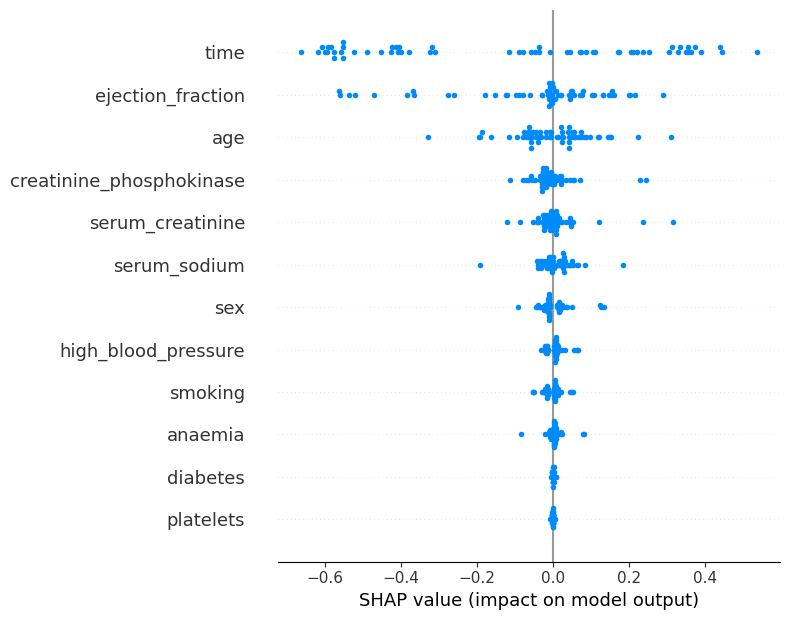

SHAP ANALYSIS FOR TUNED SVM


  0%|          | 0/61 [00:00<?, ?it/s]

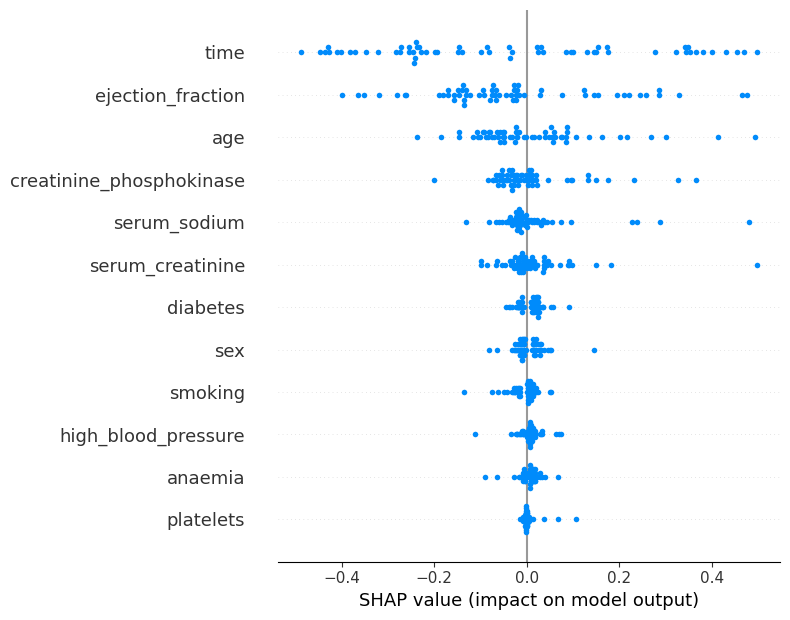

SHAP ANALYSIS FOR RANDOM FOREST


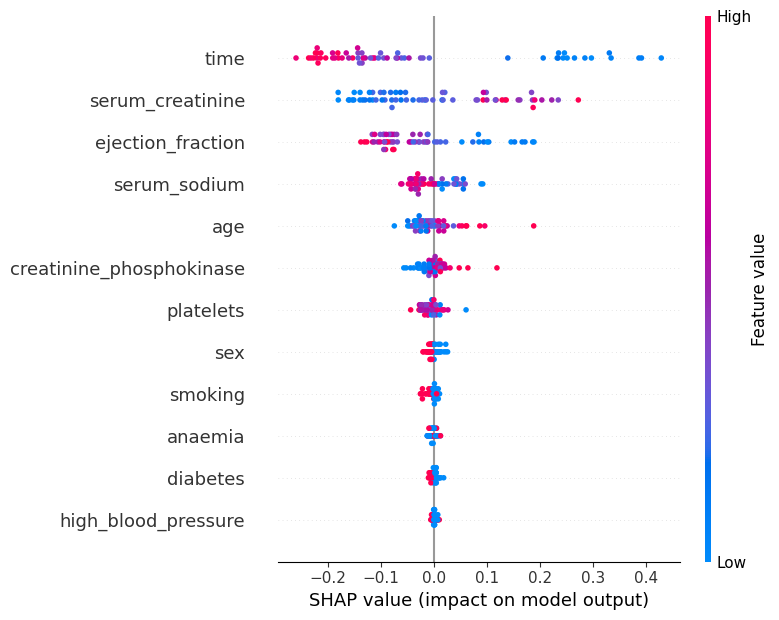

SHAP ANALYSIS FOR TUNED RANDOM FOREST


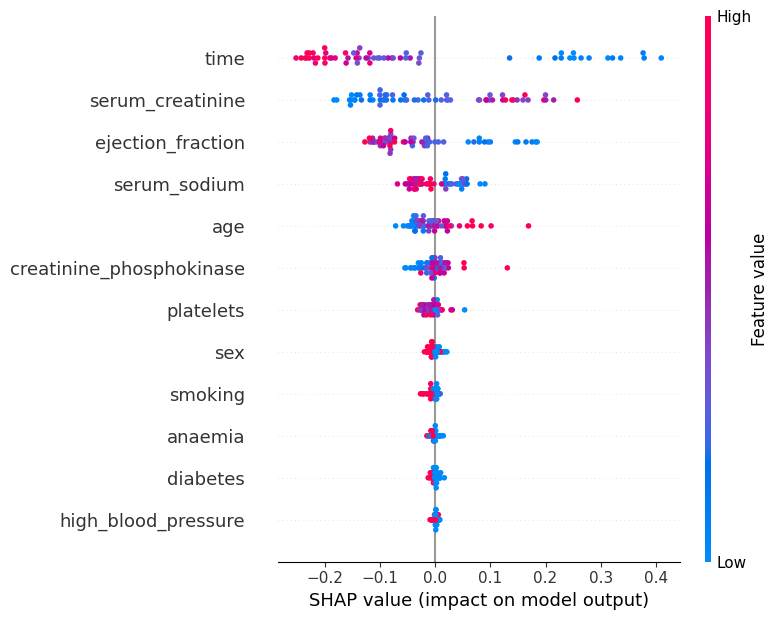

In [9]:
import shap

print("SHAP ANALYSIS FOR LOGISTIC REGRESSION")
model = trained_base_models['Logistic Regression']
explainer = shap.Explainer(model['model'], model['X_train'])
shap_values = explainer(model['X_test'])
shap.summary_plot(shap_values, model['X_test'])

print("SHAP ANALYSIS FOR LOGISTIC REGRESSION")
model = trained_base_models['Tuned Logistic Regression']
explainer = shap.Explainer(model['model'], model['X_train'])
shap_values = explainer(model['X_test'])
shap.summary_plot(shap_values, model['X_test'])

print("SHAP ANALYSIS FOR SVM")
model = trained_base_models['Support Vector Machine']
explainer = shap.KernelExplainer(model['model'].predict, model['X_train'][:50])
shap_values = explainer.shap_values(model['X_test'])
shap.summary_plot(shap_values, feature_names=df.columns[:-1])

print("SHAP ANALYSIS FOR TUNED SVM")
model = trained_base_models['Tuned Support Vector Machine']
explainer = shap.KernelExplainer(model['model'].predict, model['X_train'][:50])
shap_values = explainer.shap_values(model['X_test'])
shap.summary_plot(shap_values, feature_names=df.columns[:-1])


print("SHAP ANALYSIS FOR RANDOM FOREST")
model = trained_base_models['Random Forest']
explainer = shap.TreeExplainer(model['model'], model['X_train'])
shap_values = explainer(model['X_test'], check_additivity=False)

if len(shap_values.values.shape) == 3:
    shap_values_2d = shap_values.values[:, :, 1]
else:
    shap_values_2d = shap_values.values

shap.summary_plot(shap_values_2d, model['X_test'])

print("SHAP ANALYSIS FOR TUNED RANDOM FOREST")
model = trained_base_models['Tuned Random Forest']
explainer = shap.TreeExplainer(model['model'], model['X_train'])
shap_values = explainer(model['X_test'], check_additivity=False)

if len(shap_values.values.shape) == 3:
    shap_values_2d = shap_values.values[:, :, 1]
else:
    shap_values_2d = shap_values.values

shap.summary_plot(shap_values_2d, model['X_test'])

In [10]:
import lime
import lime.lime_tabular
import numpy as np
import matplotlib.pyplot as plt
import warnings

# Suppress annoying future warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

class_names = ['Heart Failure', 'No Heart Failure']
mode = 'classification'

print("LIME ANALYSIS FOR LOGISTIC REGRESSION")
model = trained_base_models['Logistic Regression']
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=model['X_train'].values,
    feature_names=model['X_train'].columns.tolist(),
    class_names=class_names,
    mode=mode
)
exp = explainer.explain_instance(
    data_row=model['X_test'].iloc[0].values,
    predict_fn=model['model'].predict_proba
)
exp.show_in_notebook()

print("LIME ANALYSIS FOR TUNED LOGISTIC REGRESSION")
model = trained_base_models['Tuned Logistic Regression']
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=model['X_train'].values,
    feature_names=model['X_train'].columns.tolist(),
    class_names=class_names,
    mode=mode
)
exp = explainer.explain_instance(
    data_row=model['X_test'].iloc[0].values,
    predict_fn=model['model'].predict_proba
)
exp.show_in_notebook()

print("LIME ANALYSIS FOR SVM")
model = trained_base_models['Support Vector Machine']
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=model['X_train'].values,
    feature_names=model['X_train'].columns.tolist(),
    class_names=class_names,
    mode=mode
)
exp = explainer.explain_instance(
    data_row=model['X_test'].iloc[0].values,
    predict_fn=model['model'].predict_proba
)
exp.show_in_notebook()

print("LIME ANALYSIS FOR TUNED SVM")
model = trained_base_models['Tuned Support Vector Machine']
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=model['X_train'].values,
    feature_names=model['X_train'].columns.tolist(),
    class_names=class_names,
    mode=mode
)
exp = explainer.explain_instance(
    data_row=model['X_test'].iloc[0].values,
    predict_fn=model['model'].predict_proba
)
exp.show_in_notebook()

print("LIME ANALYSIS FOR RANDOM FOREST")
model = trained_base_models['Random Forest']
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=model['X_train'].values,
    feature_names=model['X_train'].columns.tolist(),
    class_names=class_names,
    mode=mode
)
exp = explainer.explain_instance(
    data_row=model['X_test'].iloc[0].values,
    predict_fn=model['model'].predict_proba
)
exp.show_in_notebook()

print("LIME ANALYSIS FOR TUNED RANDOM FOREST")
model = trained_base_models['Tuned Random Forest']
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=model['X_train'].values,
    feature_names=model['X_train'].columns.tolist(),
    class_names=class_names,
    mode=mode
)
exp = explainer.explain_instance(
    data_row=model['X_test'].iloc[0].values,
    predict_fn=model['model'].predict_proba
)
exp.show_in_notebook()

LIME ANALYSIS FOR LOGISTIC REGRESSION


LIME ANALYSIS FOR TUNED LOGISTIC REGRESSION


LIME ANALYSIS FOR SVM


LIME ANALYSIS FOR TUNED SVM


LIME ANALYSIS FOR RANDOM FOREST


LIME ANALYSIS FOR TUNED RANDOM FOREST


### Now Lets do XIA for the complex models.

In [11]:
import lime
import lime.lime_tabular
import numpy as np
import matplotlib.pyplot as plt
import warnings

# Suppress annoying warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

# Common setup
class_names = ['Heart Failure', 'No Heart Failure']
mode = 'classification'
sample_index = 0

for model_name, model_info in trained_neural_models.items():
    print(f"\nLIME Explanation for {model_name}")

    keras_model = model_info['model']
    X_train = model_info['X_train_original']
    X_test = model_info['X_test_original']

    # Define a LIME-compatible predict_proba wrapper
    def make_predict_proba(model):
        def predict_proba_wrapper(input_data):
            input_data = np.array(input_data).astype(np.float32)
            input_data = np.expand_dims(input_data, axis=-1)
            proba = model.predict(input_data)

            # Handle binary classification sigmoid output
            if proba.shape[1] == 1:
                proba = np.hstack([1 - proba, proba])
            return proba
        return predict_proba_wrapper

    # Initialize LIME explainer
    explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=X_train.values,
        feature_names=X_train.columns.tolist(),
        class_names=class_names,
        mode=mode
    )

    # Select one instance to explain
    instance = X_test.iloc[sample_index].values

    # Explain using LIME
    exp = explainer.explain_instance(
        data_row=instance,
        predict_fn=make_predict_proba(keras_model),
        num_features=10
    )

    # Show interactive output in notebook
    exp.show_in_notebook()



LIME Explanation for CNN
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step



LIME Explanation for LSTM
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step



LIME Explanation for CNN_LSTM
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step



LIME Explanation for BiLSTM
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step



LIME Explanation for GRU
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step



LIME Explanation for CNN_Attention
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


### Patient Feature Values (Standardized)

| Feature                    | Value  |
|---------------------------|--------|
| `time`                    | 1.47   |
| `age`                     | -1.42  |
| `smoking`                 | 1.00   |
| `ejection_fraction`       | -0.68  |
| `sex`                     | 1.00   |
| `high_blood_pressure`     | 1.00   |
| `serum_sodium`            | -1.50  |
| `anaemia`                 | 0.00   |
| `creatinine_phosphokinase`| 6.37   |
| `diabetes`                | 1.00   |
| `serum_creatinine`        | 0.96   |
| `platelets`               | 12.48  |


### Logistic Regression (Tuned)

- **Predicted Probability: 0.98 → **Heart Failure****
- **Top 5 Contributing Features**:
  - `time > 0.73` → +0.46
  - `age <= -0.66` → +0.13
  - `ejection_fraction > -1.02` → +0.08
  - `sex = 1` → +0.08
  - `smoking = 1` → +0.08

### SVM (Tuned)

- **Predicted Probability: 0.83 → **Heart Failure****
- **Top 5 Contributing Features**:
  - `time > 0.73` → +0.37
  - `age <= -0.66` → +0.16
  - `serum_sodium <= -0.60` → +0.11
  - `ejection_fraction > -1.02` → +0.05
  - `diabetes = 1` → +0.05

### Random Forest (Tuned)

- **Predicted Probability: 0.55 → **Heart Failure****
- **Top 5 Contributing Features**:
  - `time > 0.73` → +0.28
  - `serum_sodium <= -0.60` → +0.07
  - `serum_creatinine > 0.78` → +0.06
  - `age <= -0.66` → +0.04
  - `creatinine_phosphokinase > 5.55` → +0.03

### CNN

- **Predicted Probability: 0.97 → **Heart Failure****
- **Top 5 Contributing Features**:
  - `time > 0.73` → +0.34
  - `sex = 1` → +0.13
  - `high_blood_pressure = 1` → +0.08
  - `diabetes = 1` → +0.07
  - `ejection_fraction > -1.02` → +0.05

### LSTM

- **Predicted Probability: 0.94 → **Heart Failure****
- **Top 5 Contributing Features**:
  - `time > 0.73` → +0.37
  - `diabetes = 1` → +0.11
  - `serum_sodium <= -0.60` → +0.10
  - `age <= -0.66` → +0.09
  - `high_blood_pressure = 1` → +0.07

### CNN + LSTM

- **Predicted Probability: 1.00 → **Heart Failure****
- **Top 5 Contributing Features**:
  - `time > 0.73` → +0.30
  - `age <= -0.66` → +0.14
  - `high_blood_pressure = 1` → +0.10
  - `diabetes = 1` → +0.09
  - `serum_sodium <= -0.60` → +0.08

### BiLSTM

- **Predicted Probability: 0.99 → **Heart Failure****
- **Top 5 Contributing Features**:
  - `time > 0.73` → +0.44
  - `age <= -0.66` → +0.14
  - `smoking = 1` → +0.13
  - `serum_sodium <= -0.60` → +0.11
  - `high_blood_pressure = 1` → +0.10